<a href="https://colab.research.google.com/github/mariferreras/personal-projects/blob/main/random_forest_sample.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn import tree
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV

from tqdm import tqdm

import warnings
warnings.filterwarnings('once')

import io
from google.colab import files
uploaded = files.upload()

Saving adults_encoding.csv to adults_encoding.csv


In [ ]:
df = pd.read_csv("adults_encoding.csv", index_col = 0)
df.head(2)

,education_yrs,capital_gain,capital_lost,hours_week,salary,gender_map,relationship_ Husband,relationship_ Not-in-family,relationship_ Other-relative,relationship_ Own-child,...,country_ Portugal,country_ Puerto-Rico,country_ Scotland,country_ South,country_ Taiwan,country_ Thailand,country_ Trinadad&Tobago,country_ United-States,country_ Vietnam,country_ Yugoslavia
39,,,,,,,,,,,,,,,,,,,,,
50,-0.333333,0.0,0.0,-2.0,24006,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
38,0.666667,0.0,0.0,0.0,44640,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
df_1 = df.sample(10000)

In [ ]:
X = df.drop("salary", axis = 1)
y = df["salary"]

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [ ]:
bosque = RandomForestRegressor()

In [ ]:
bosque.fit(x_train, y_train)

RandomForestRegressor()

In [ ]:
max_features = np.sqrt(len(x_train.columns))
print(max_features)

9.433981132056603


In [ ]:
param = {"max_depth": [3,6,7],
        "max_features": [1,3,4,6,9],
        "min_samples_split": [15, 30, 60],
        "min_samples_leaf": [15, 30, 60]} 

In [ ]:
gs_rf = GridSearchCV(
            estimator=RandomForestRegressor(),
            param_grid= param,
            cv=10,  
            verbose=-1,
            return_train_score = True,
            scoring="neg_mean_squared_error")

In [ ]:
gs_rf.fit(x_train, y_train)

GridSearchCV(cv=10, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [3, 6, 7],
                         'max_features': [1, 3, 4, 6, 9],
                         'min_samples_leaf': [15, 30, 60],
                         'min_samples_split': [15, 30, 60]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=-1)

In [ ]:
bosque_mejor = gs_rf.best_estimator_
bosque_mejor

RandomForestRegressor(max_depth=7, max_features=9, min_samples_leaf=15,
                      min_samples_split=30)

  0%|          | 0/100 [00:00<?, ?it/s]

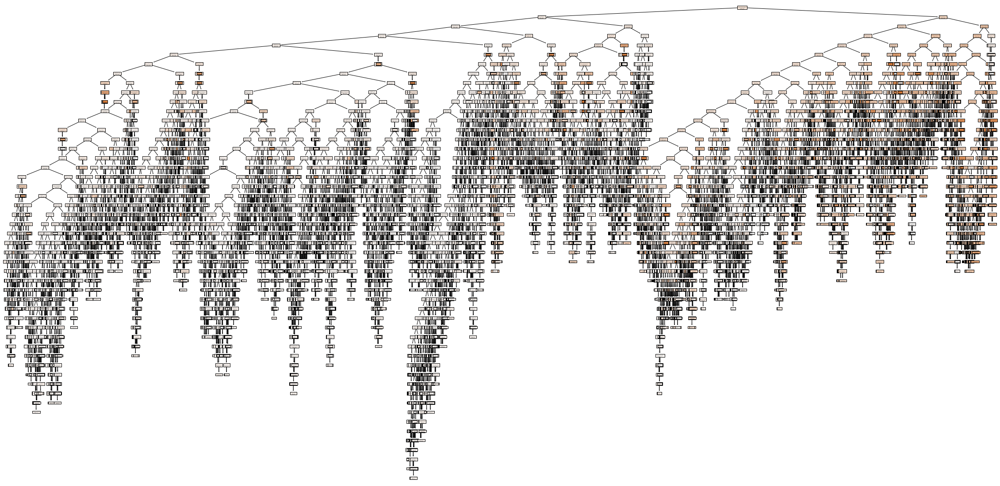

  1%|          | 1/100 [06:44<11:07:25, 404.50s/it]

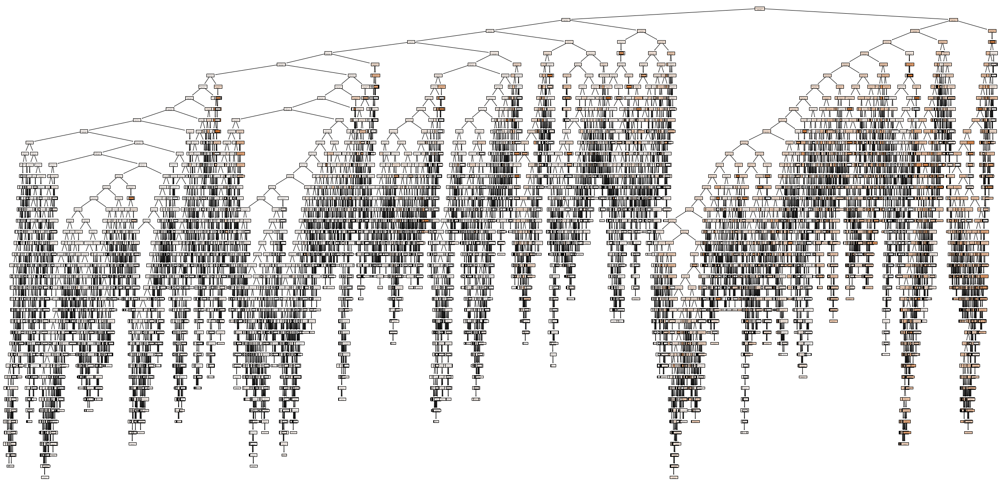

  2%|▏         | 2/100 [13:24<10:56:14, 401.78s/it]

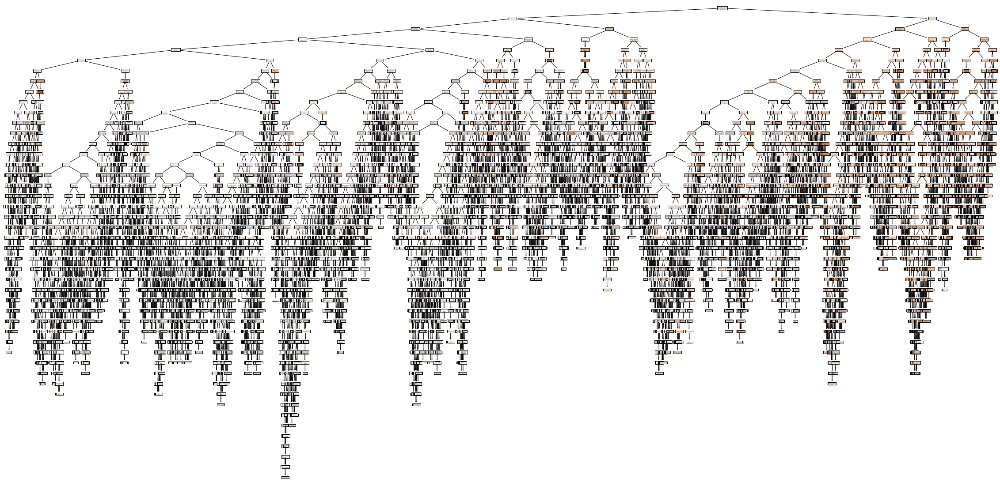

  3%|▎         | 3/100 [20:05<10:49:23, 401.68s/it]

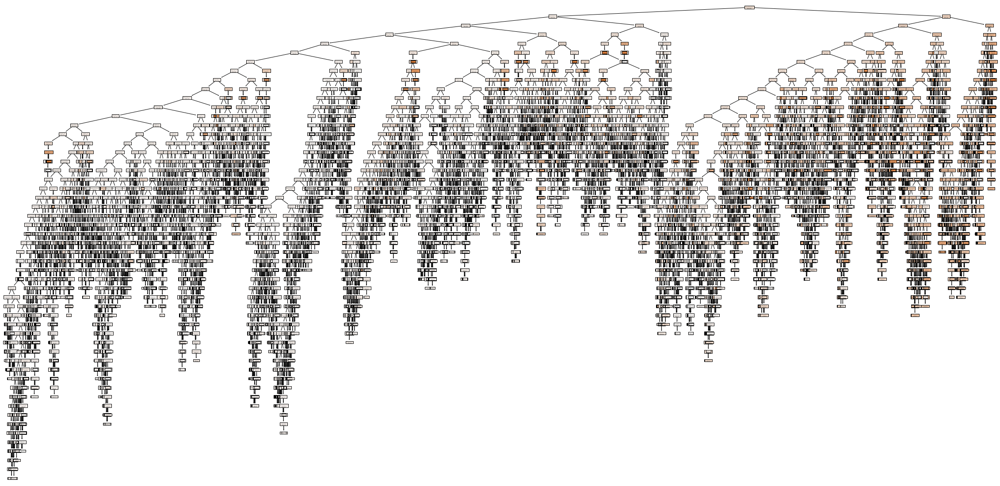

  4%|▍         | 4/100 [26:49<10:43:54, 402.44s/it]

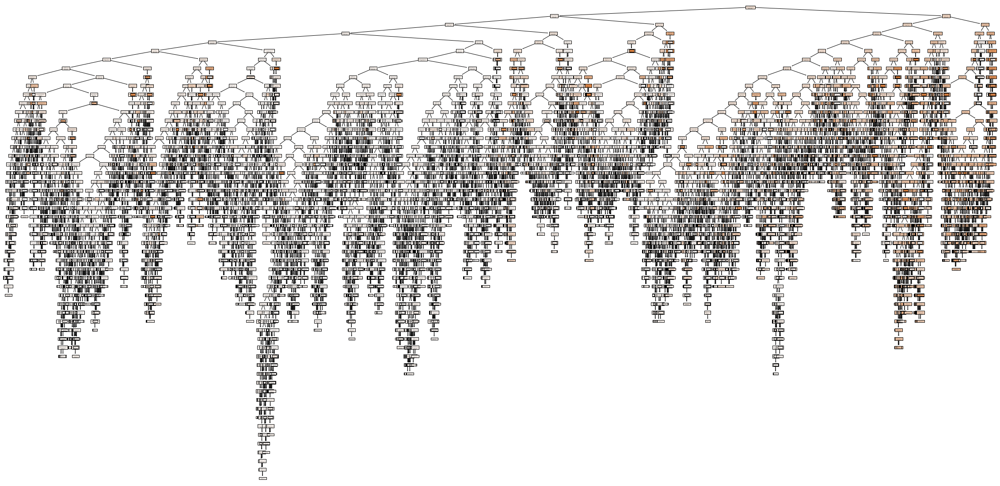

  5%|▌         | 5/100 [33:27<10:34:43, 400.88s/it]

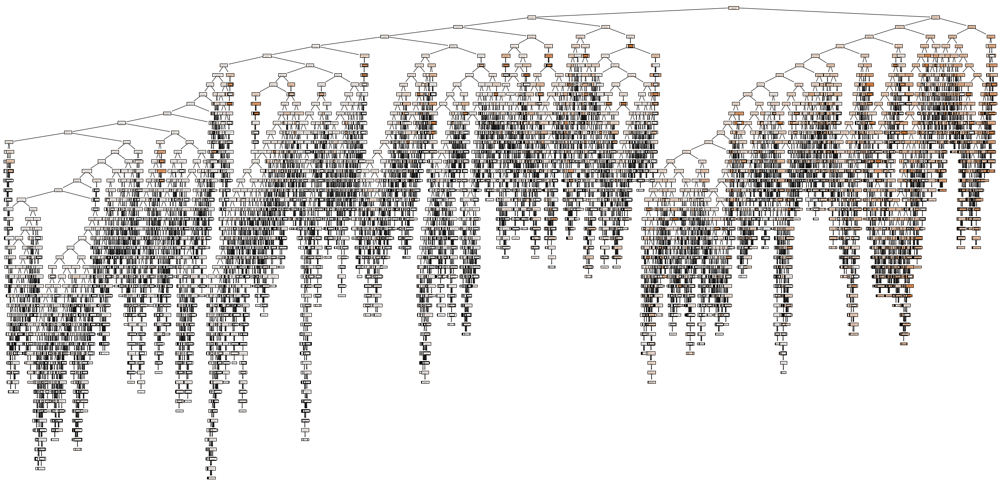

  6%|▌         | 6/100 [40:07<10:27:34, 400.58s/it]

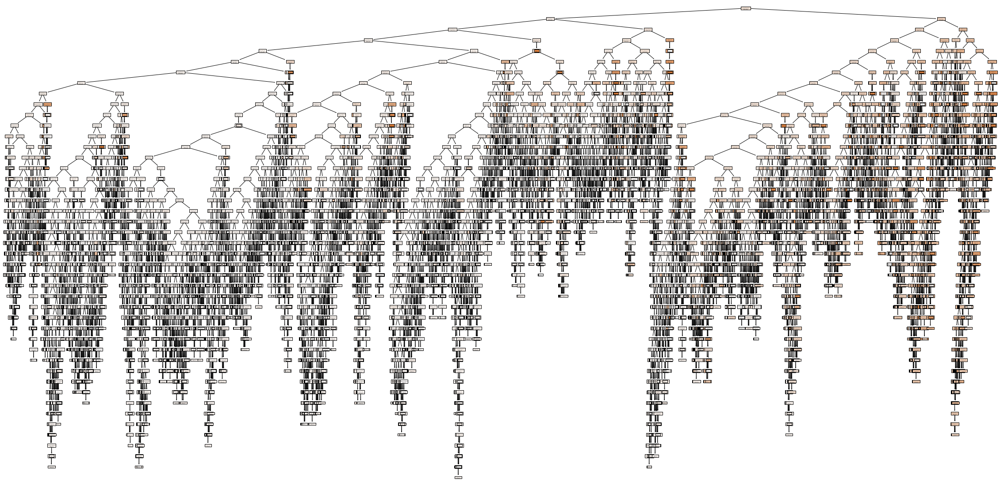

  7%|▋         | 7/100 [46:48<10:21:13, 400.79s/it]

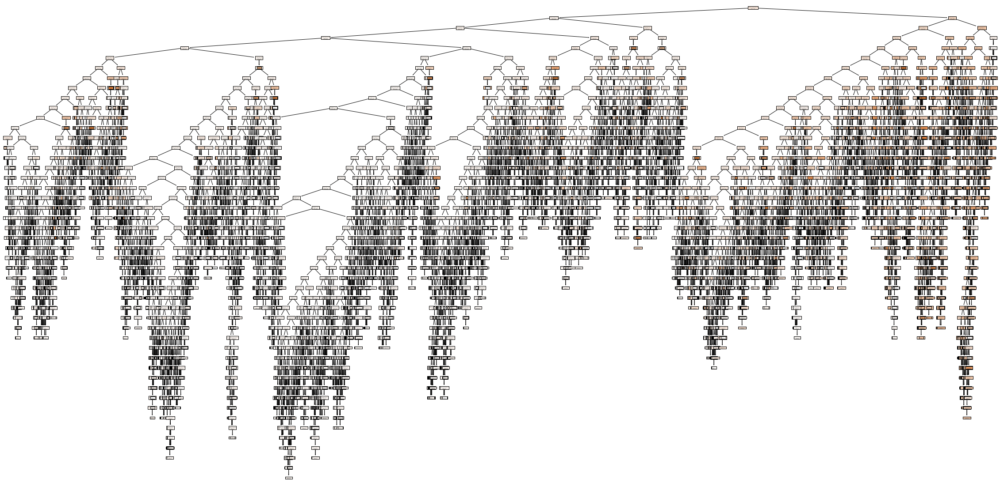

  8%|▊         | 8/100 [53:30<10:14:47, 400.95s/it]

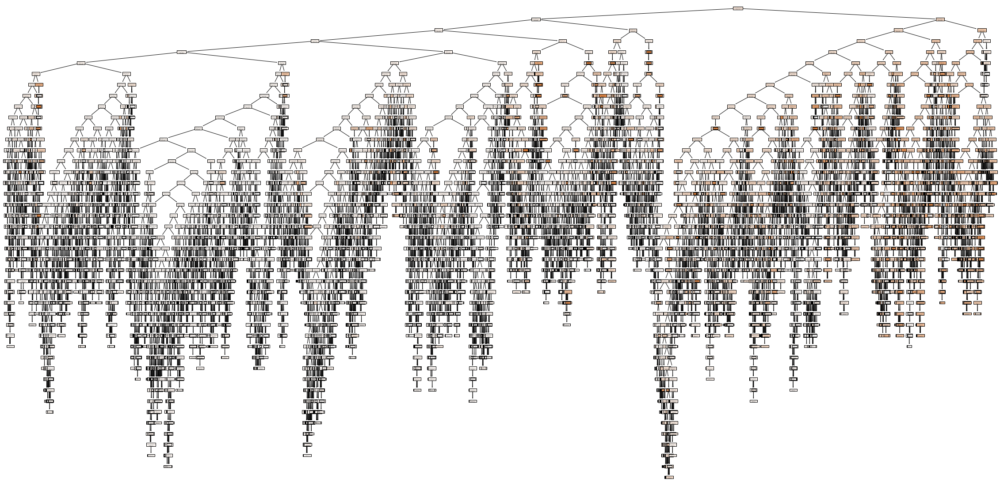

  9%|▉         | 9/100 [1:00:15<10:10:07, 402.28s/it]

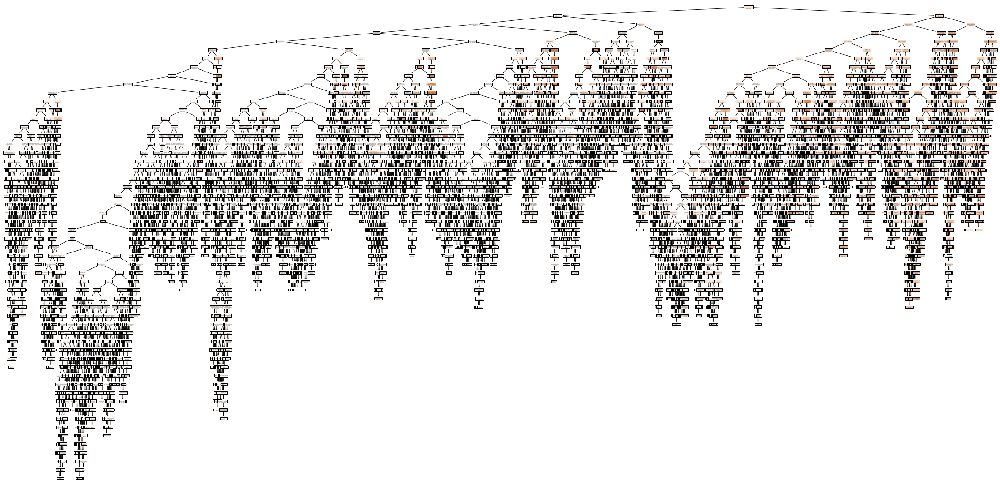

 10%|█         | 10/100 [1:06:55<10:02:16, 401.52s/it]

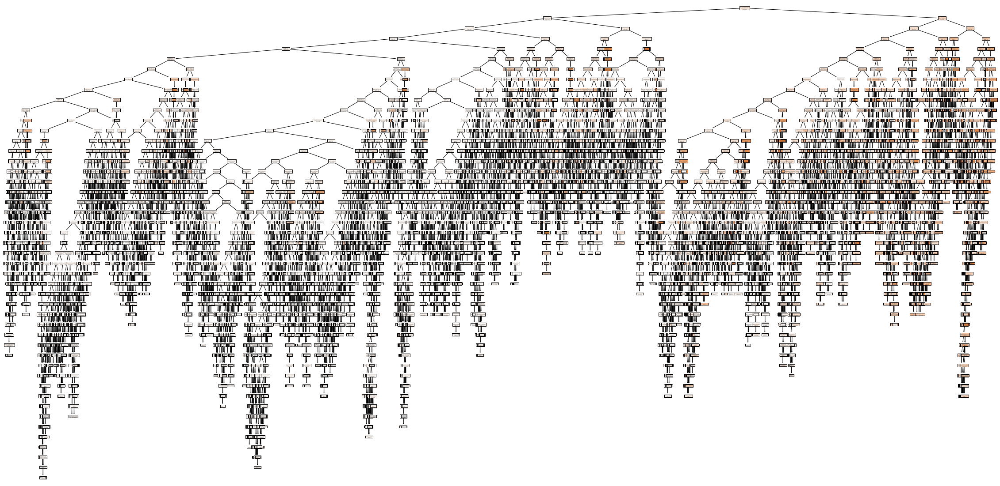

 11%|█         | 11/100 [1:13:39<9:56:39, 402.24s/it] 

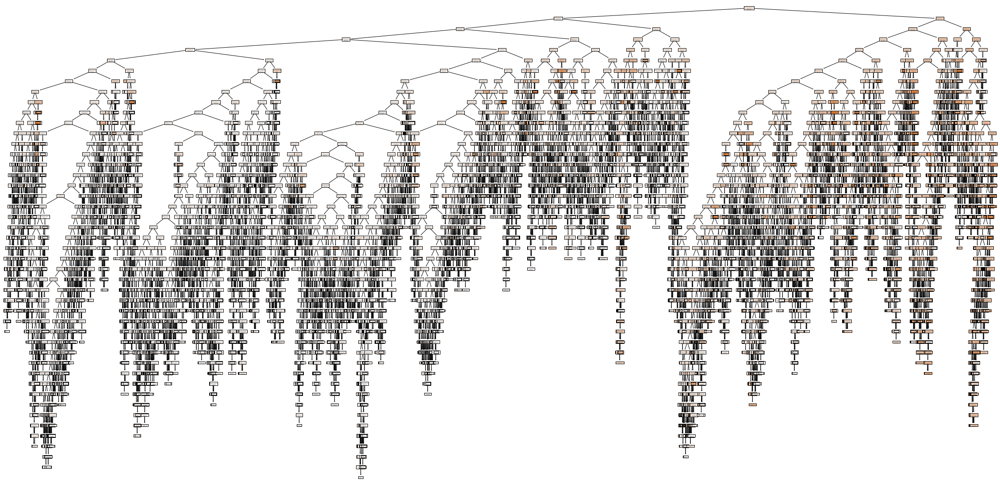

 12%|█▏        | 12/100 [1:20:27<9:52:50, 404.20s/it]

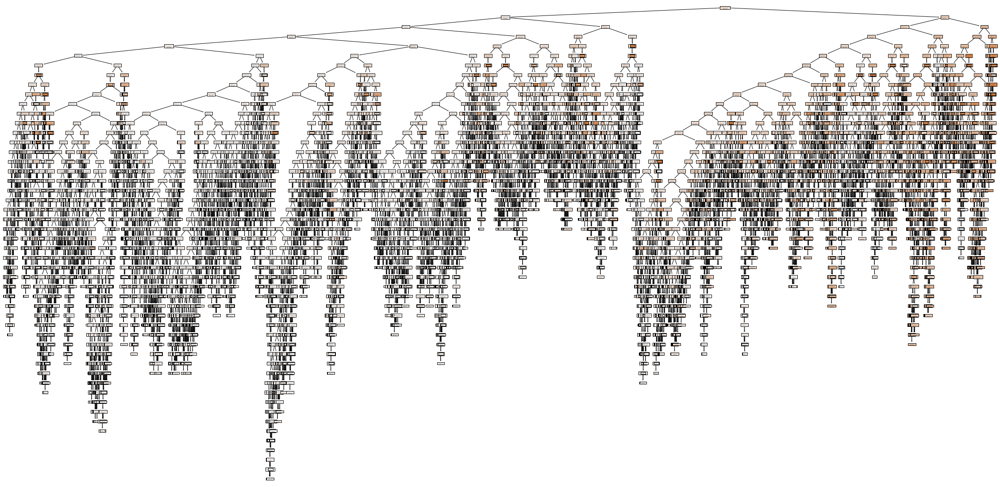

 13%|█▎        | 13/100 [1:27:11<9:45:54, 404.07s/it]

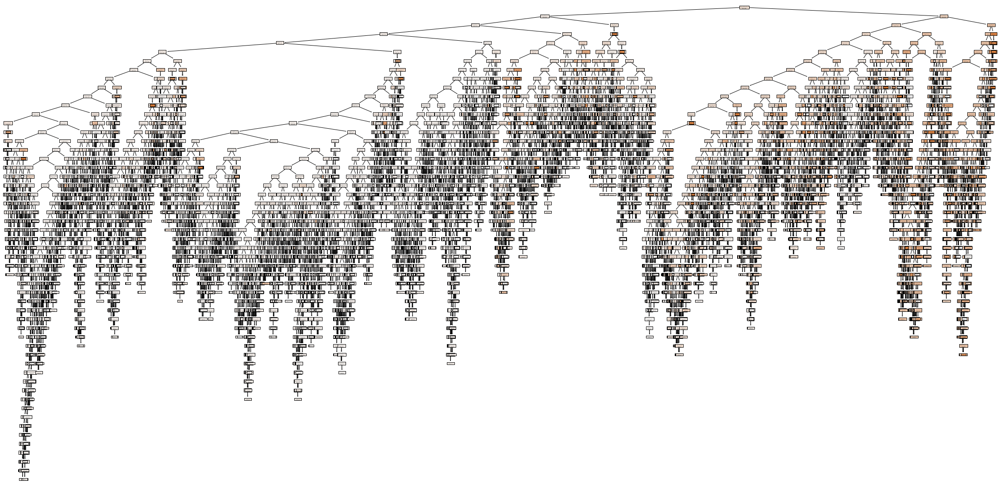

 14%|█▍        | 14/100 [1:33:51<9:37:16, 402.75s/it]

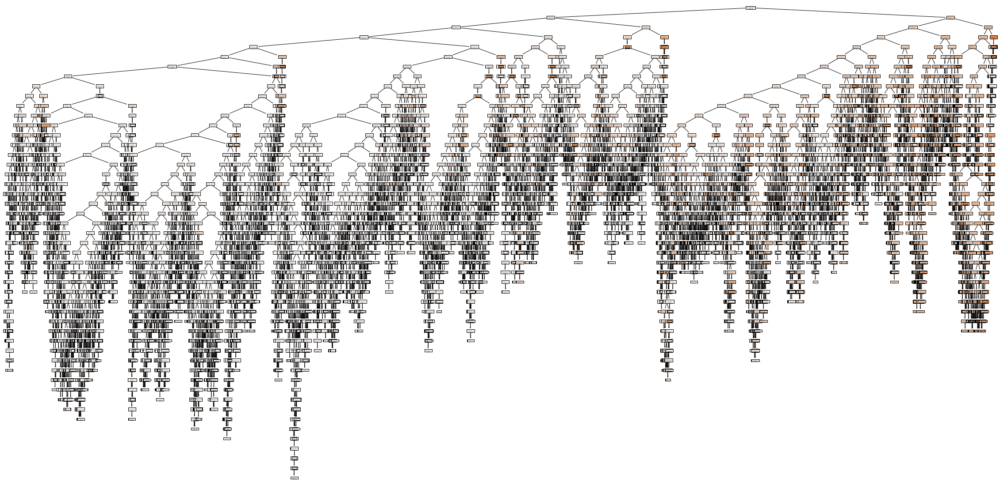

 15%|█▌        | 15/100 [1:40:36<9:31:50, 403.65s/it]

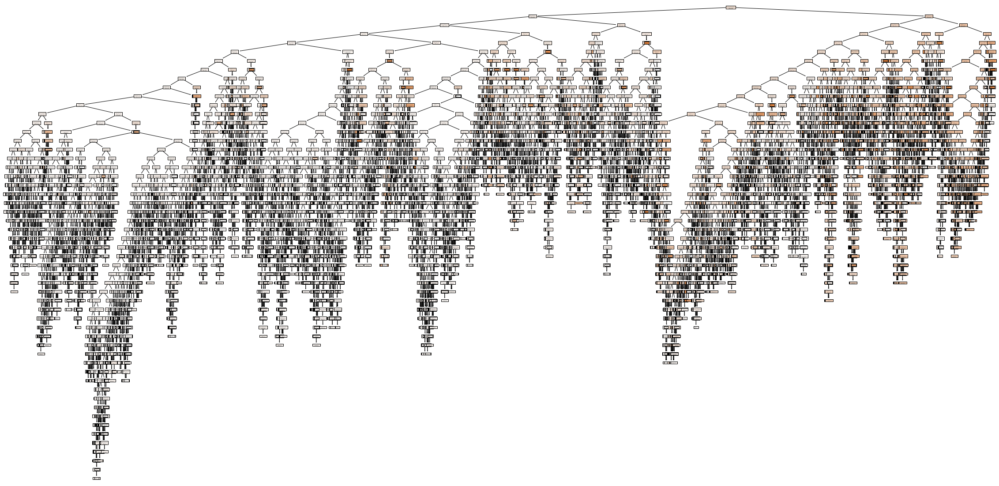

 16%|█▌        | 16/100 [1:47:16<9:23:20, 402.39s/it]

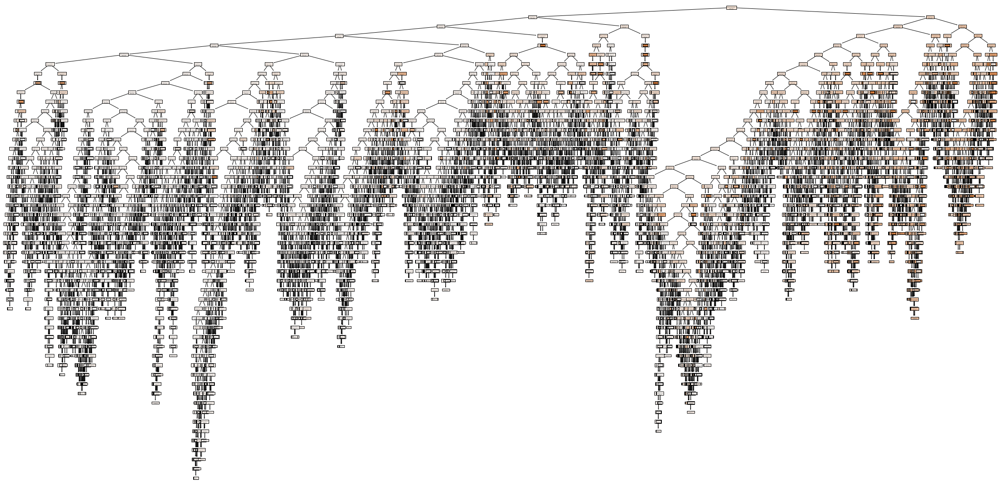

 17%|█▋        | 17/100 [1:54:02<9:18:20, 403.62s/it]

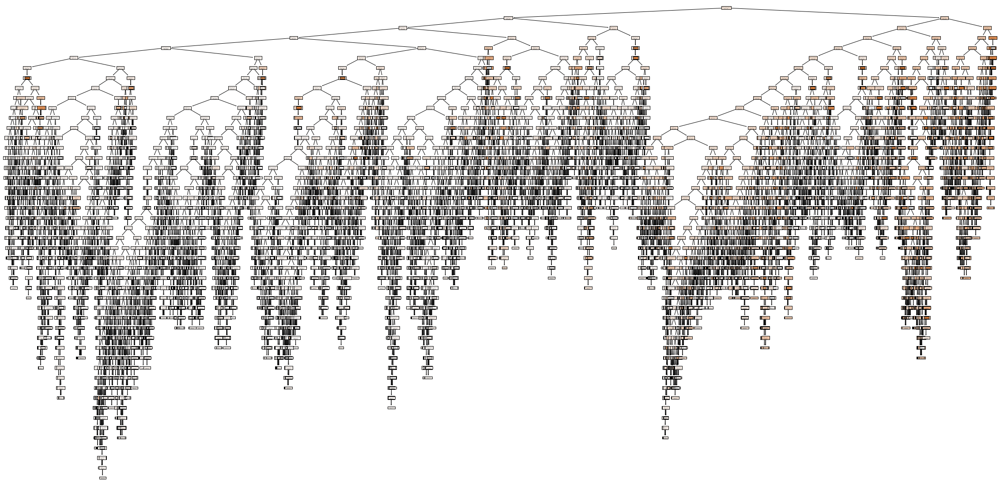

 18%|█▊        | 18/100 [2:00:50<9:13:26, 404.95s/it]

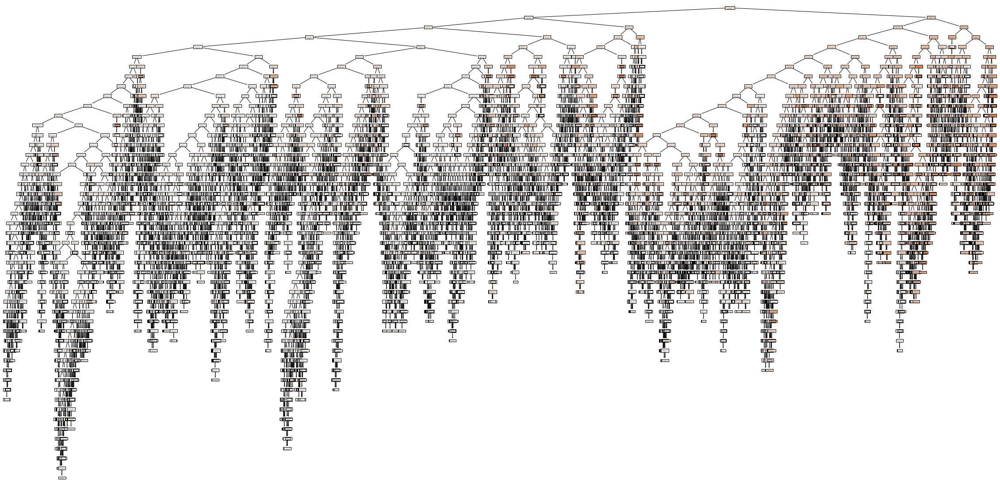

 19%|█▉        | 19/100 [2:07:41<9:08:50, 406.55s/it]

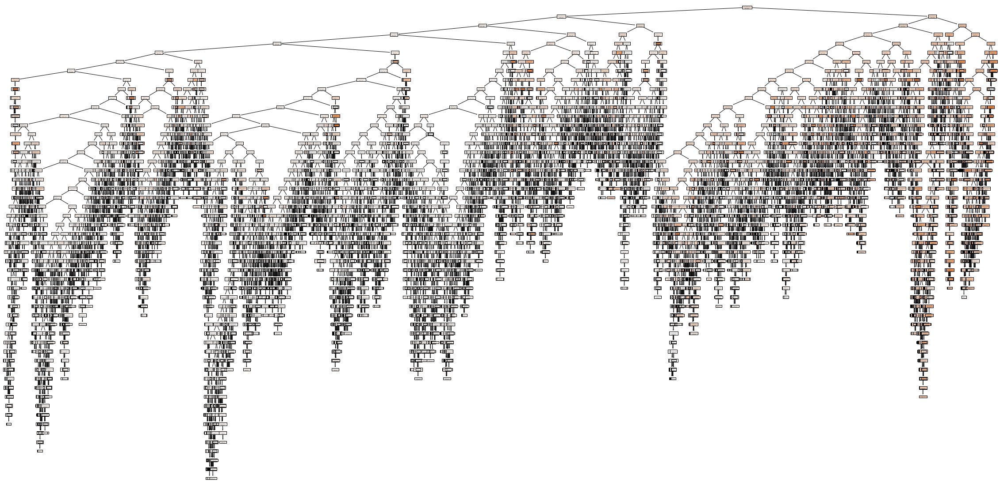

 20%|██        | 20/100 [2:14:34<9:04:47, 408.59s/it]

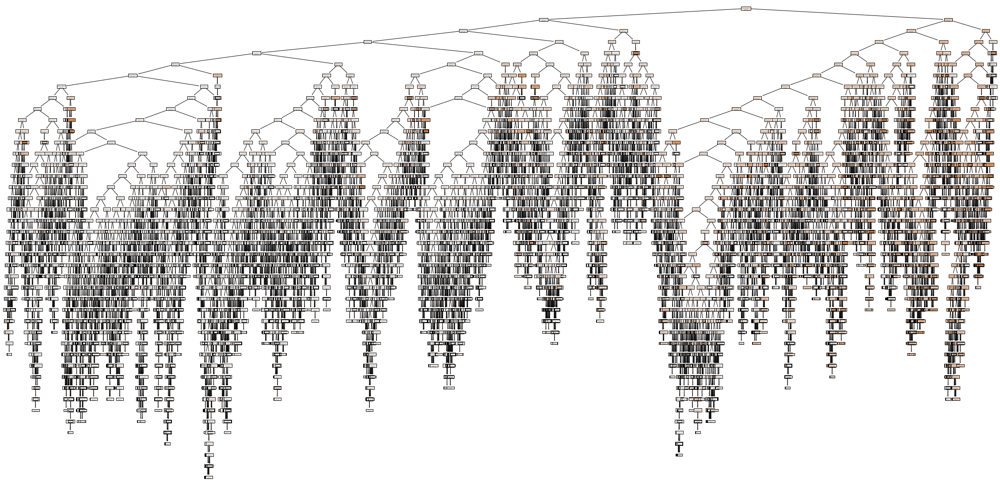

 21%|██        | 21/100 [2:21:27<8:59:44, 409.92s/it]

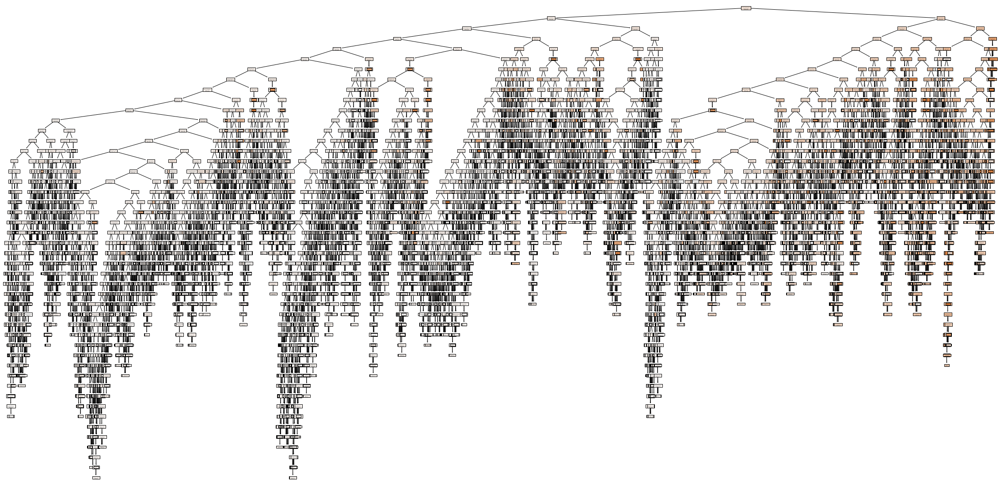

 22%|██▏       | 22/100 [2:28:12<8:50:48, 408.32s/it]

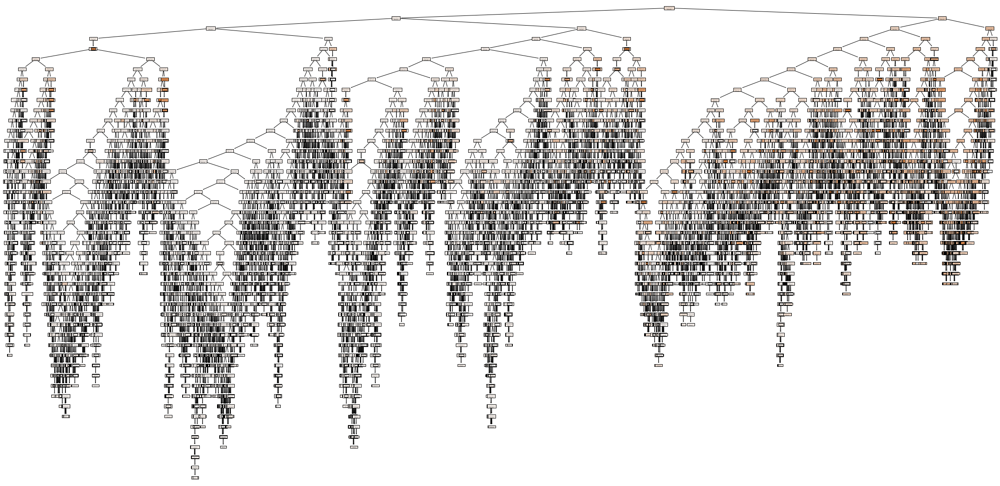

 23%|██▎       | 23/100 [2:35:00<8:44:08, 408.42s/it]

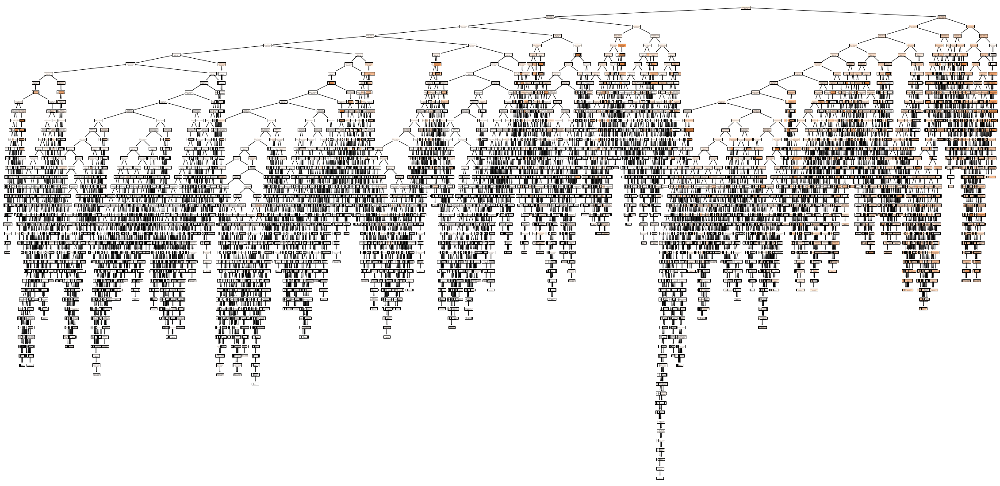

 24%|██▍       | 24/100 [2:41:43<8:35:03, 406.62s/it]

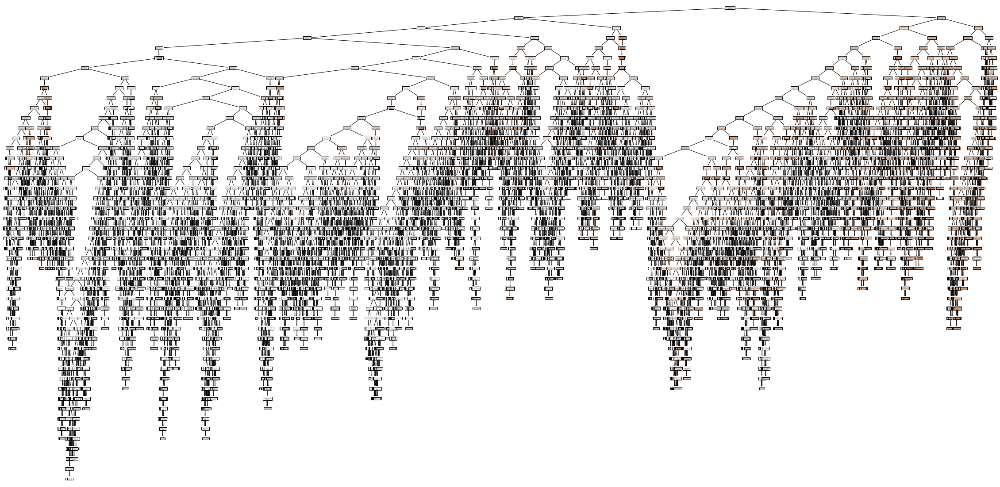

 25%|██▌       | 25/100 [2:48:21<8:25:18, 404.24s/it]

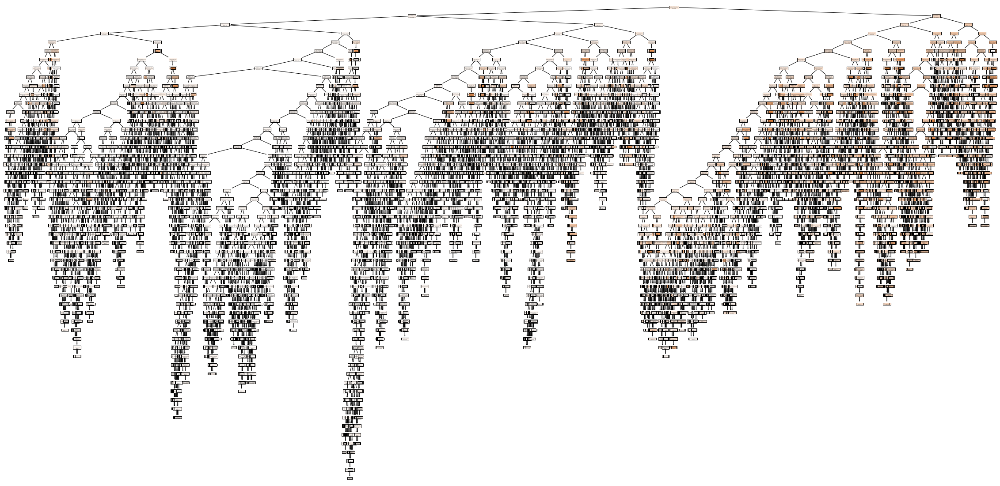

 26%|██▌       | 26/100 [2:54:54<8:14:24, 400.87s/it]

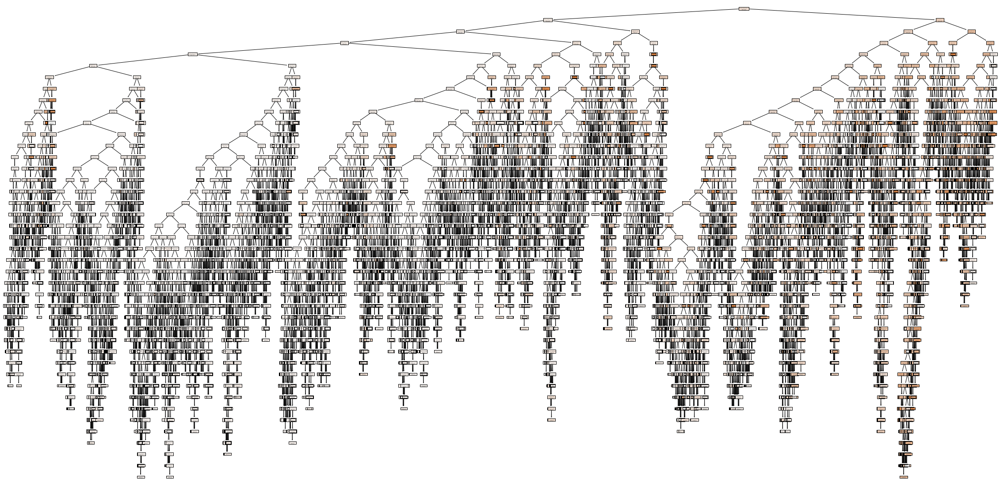

 27%|██▋       | 27/100 [3:01:37<8:08:10, 401.24s/it]

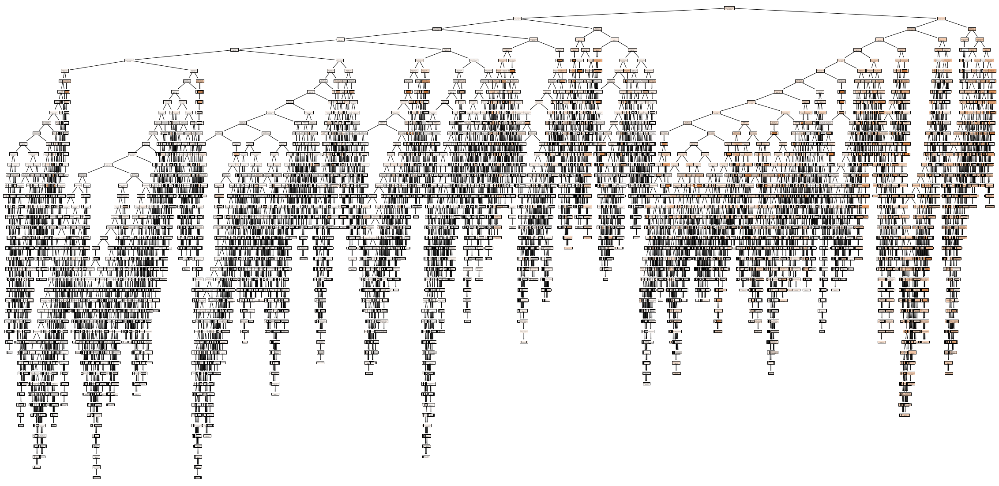

 28%|██▊       | 28/100 [3:08:16<8:00:53, 400.74s/it]

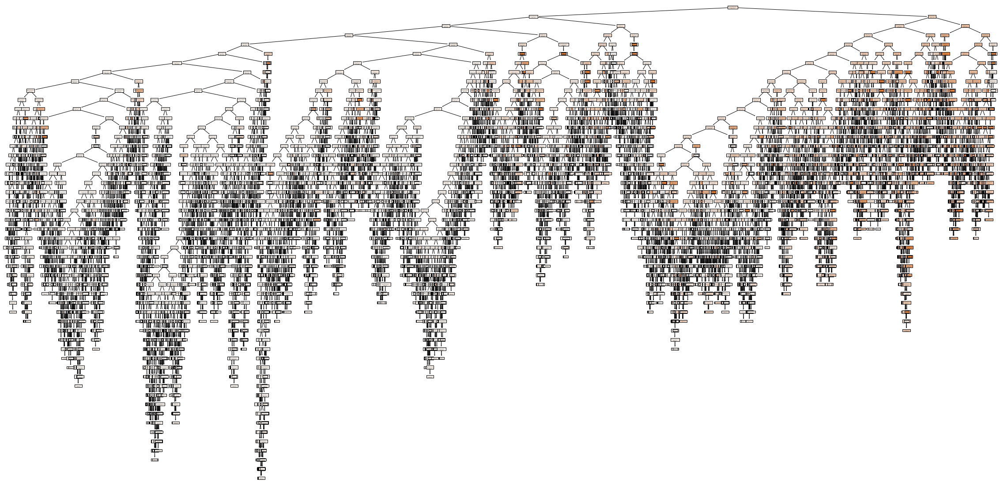

 29%|██▉       | 29/100 [3:15:04<7:56:35, 402.75s/it]

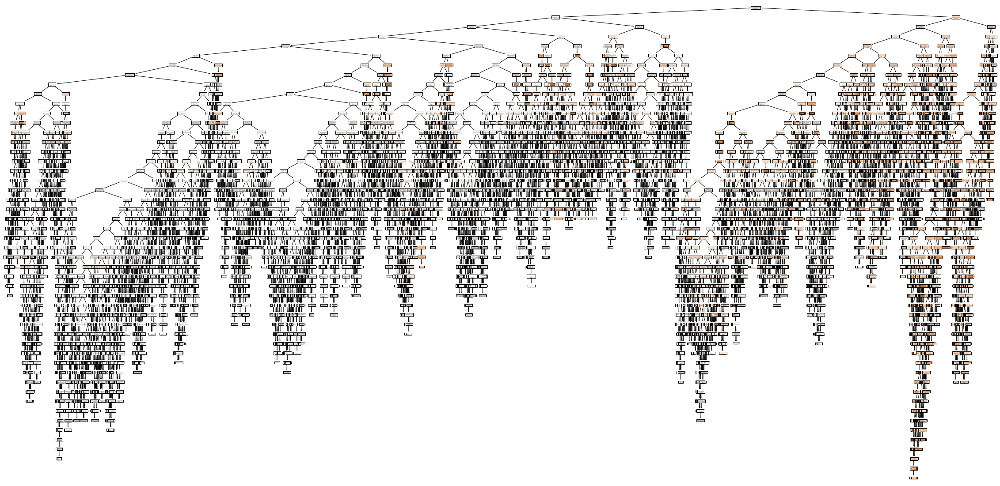

 30%|███       | 30/100 [3:21:55<7:52:51, 405.31s/it]

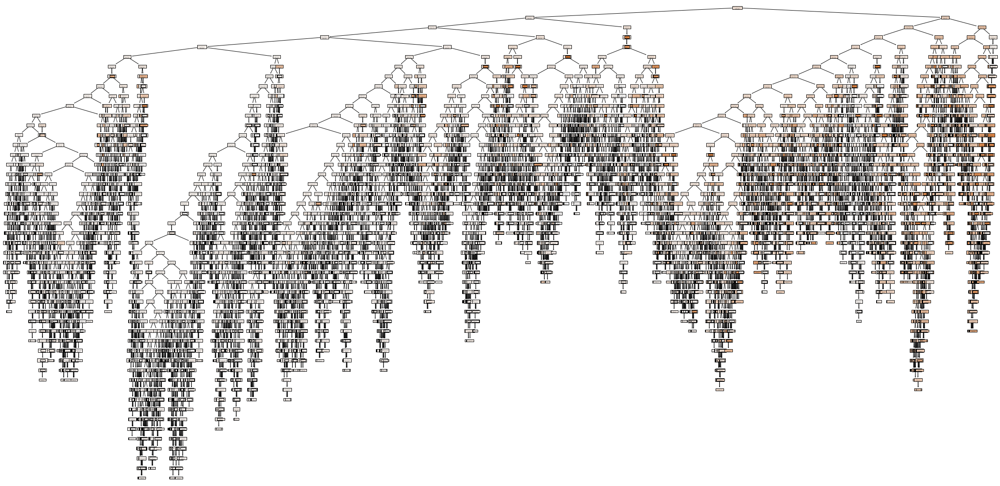

 31%|███       | 31/100 [3:28:39<7:45:38, 404.91s/it]

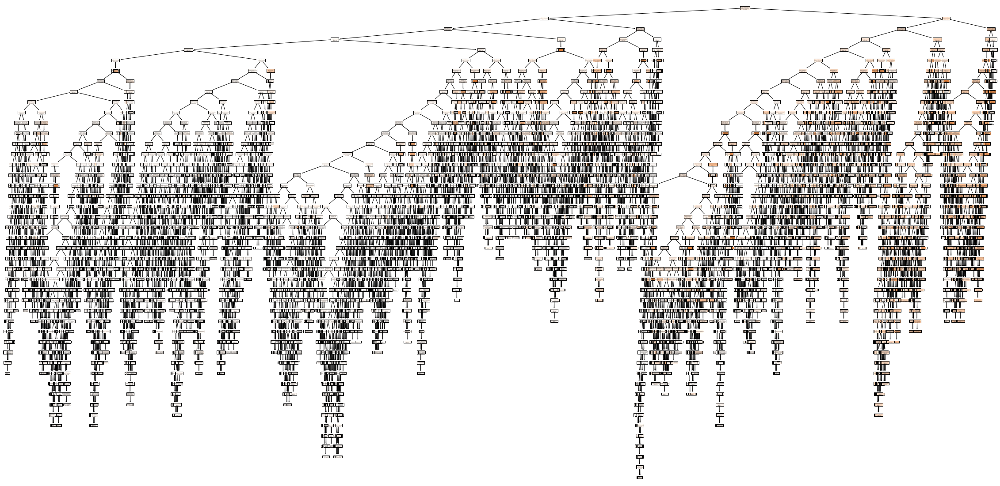

 32%|███▏      | 32/100 [3:35:27<7:39:52, 405.77s/it]

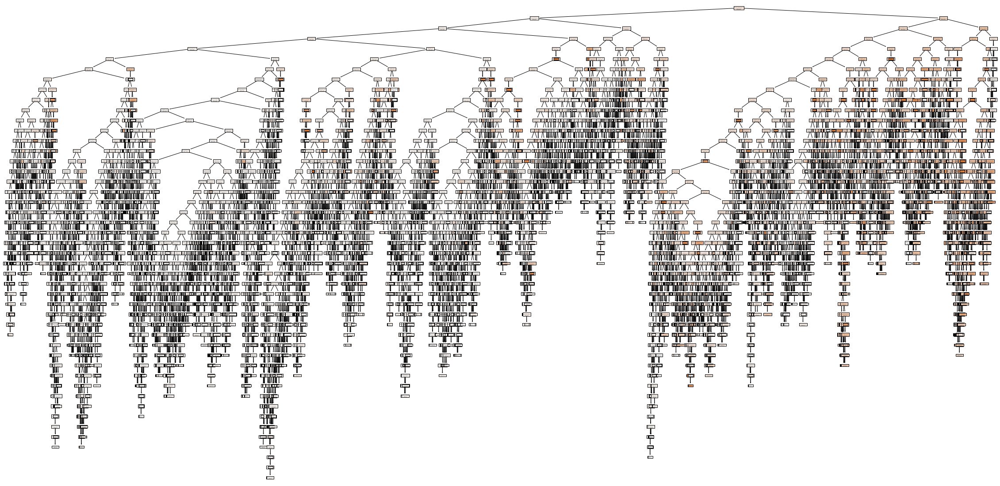

 33%|███▎      | 33/100 [3:42:13<7:33:15, 405.90s/it]

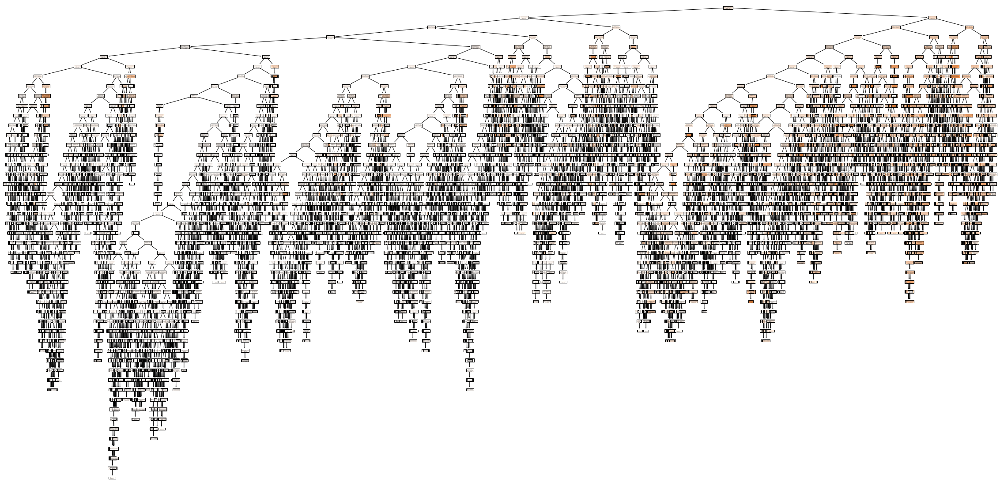

 34%|███▍      | 34/100 [3:49:00<7:26:48, 406.19s/it]

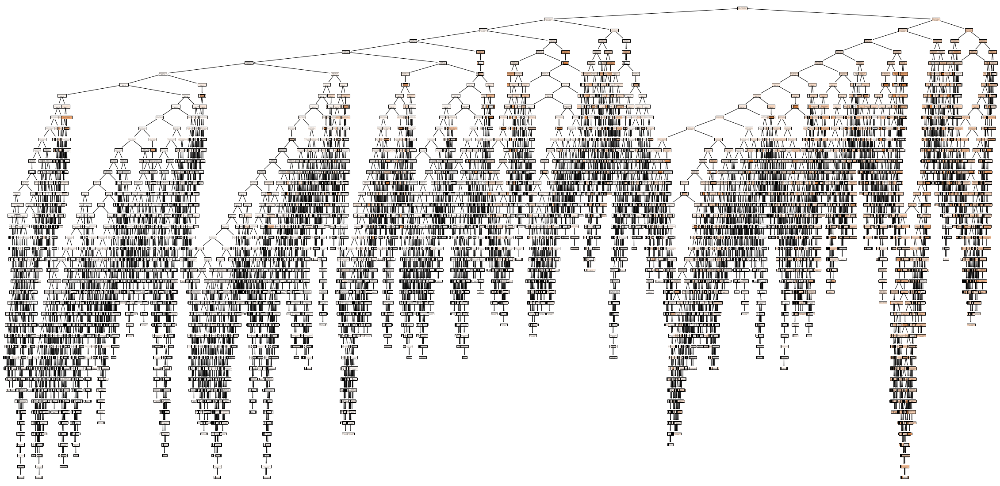

 35%|███▌      | 35/100 [3:55:45<7:19:44, 405.92s/it]

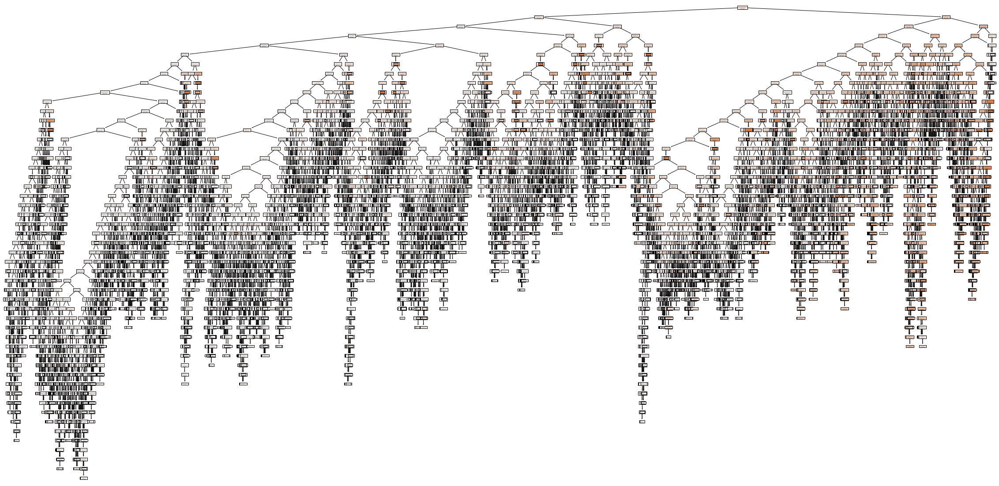

 36%|███▌      | 36/100 [4:02:35<7:14:25, 407.27s/it]

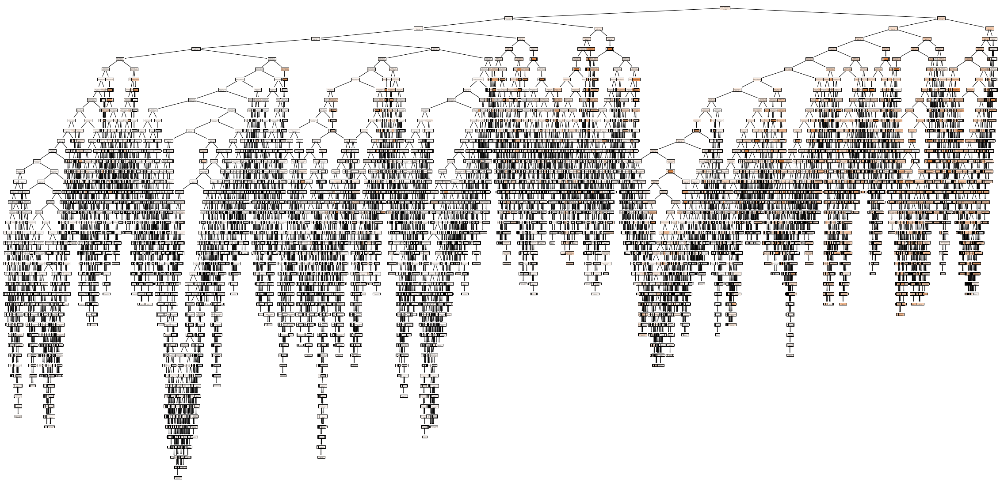

 37%|███▋      | 37/100 [4:09:26<7:08:32, 408.13s/it]

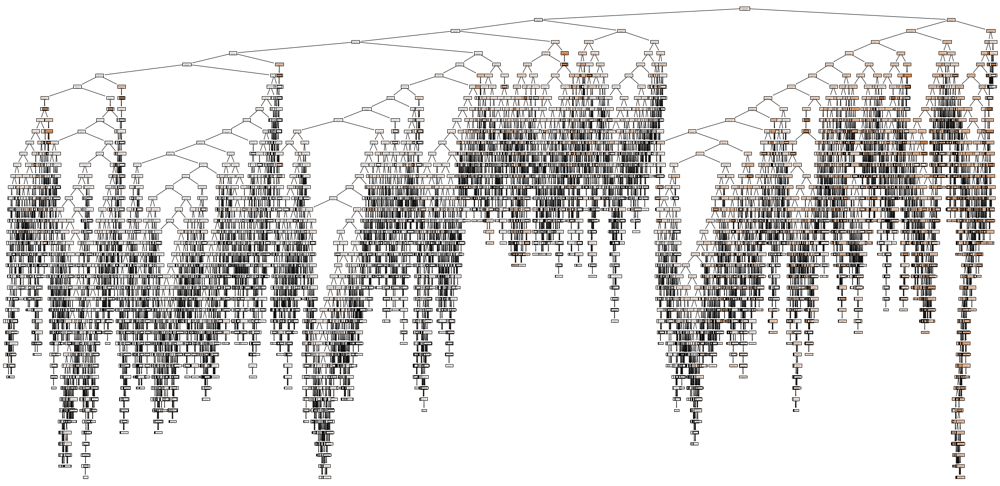

 38%|███▊      | 38/100 [4:16:17<7:02:44, 409.10s/it]

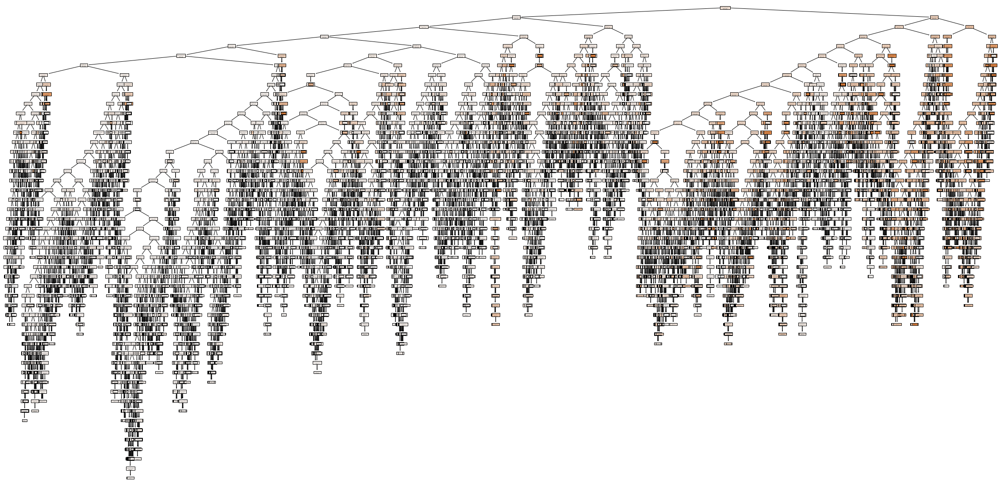

 39%|███▉      | 39/100 [4:23:07<6:56:21, 409.53s/it]

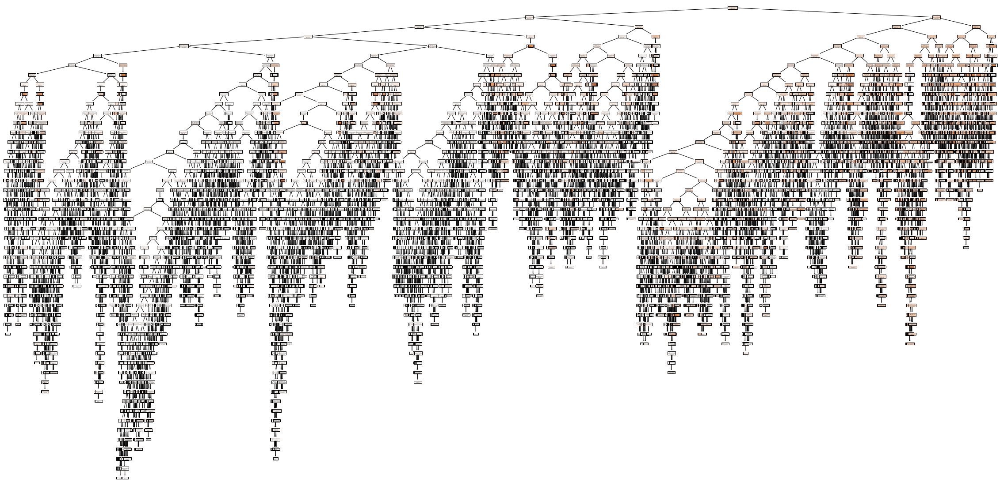

 40%|████      | 40/100 [4:29:55<6:48:56, 408.93s/it]

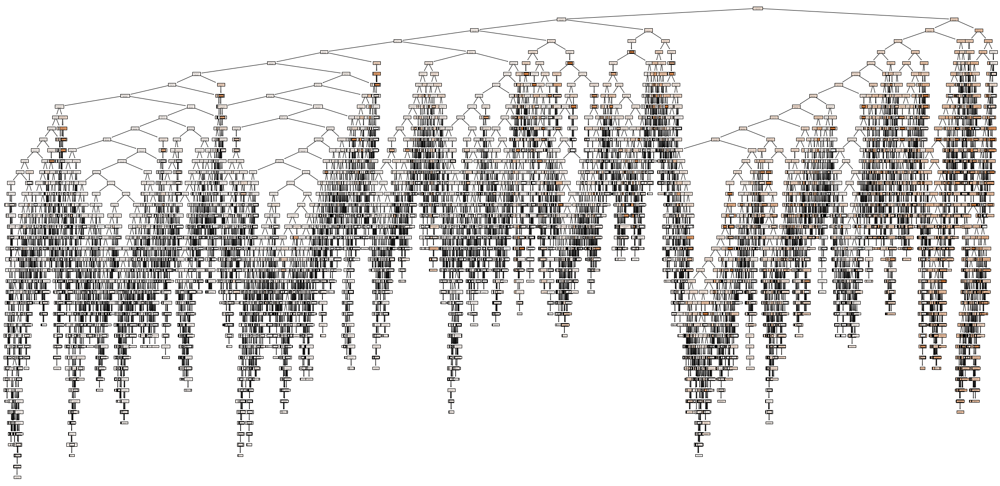

 41%|████      | 41/100 [4:36:40<6:40:55, 407.72s/it]

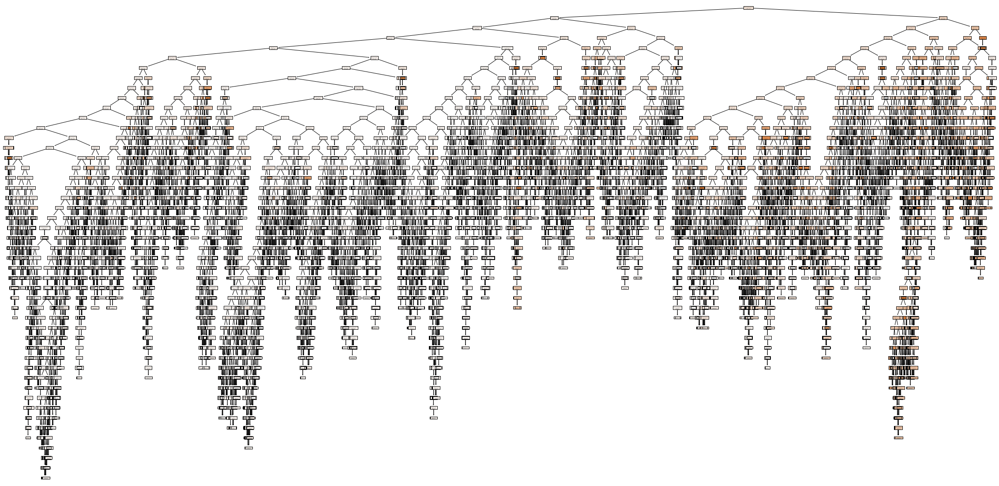

 42%|████▏     | 42/100 [4:43:28<6:34:13, 407.83s/it]

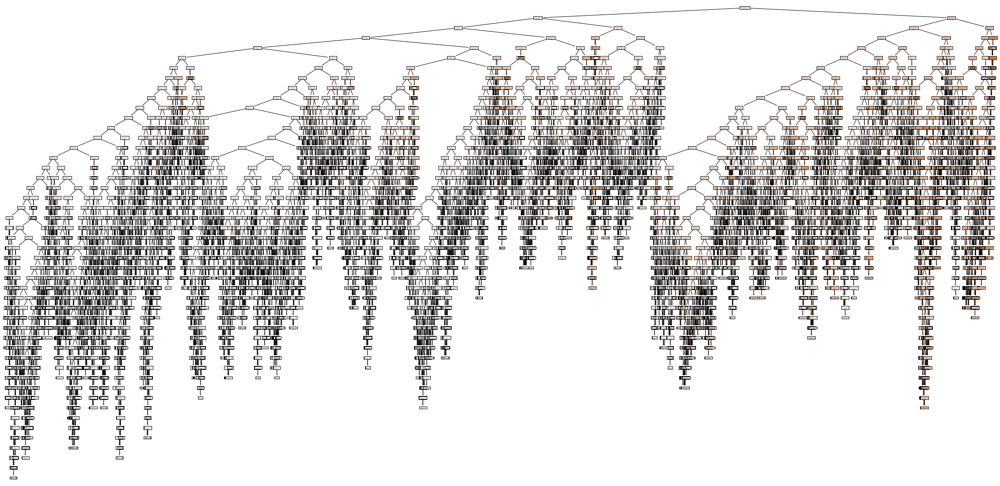

 43%|████▎     | 43/100 [4:50:19<6:28:16, 408.70s/it]

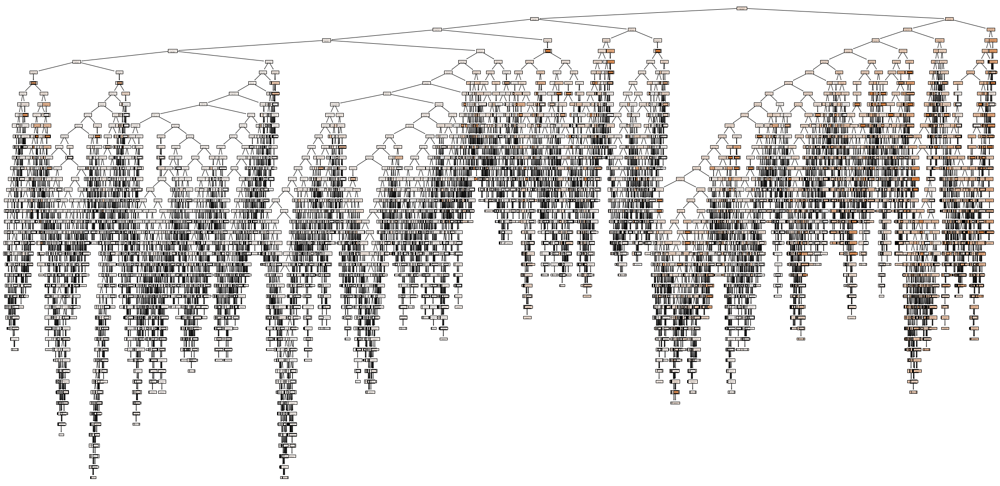

 44%|████▍     | 44/100 [4:57:09<6:21:49, 409.10s/it]

In [ ]:
for arbol in tqdm(bosque.estimators_):
    fig = plt.figure(figsize=(40, 20))
    tree.plot_tree(arbol, feature_names= x_train.columns, filled = True)
    plt.show()

In [ ]:
y_pred_test_rf = bosque.predict(x_test)
y_pred_train_rf = bosque.predict(x_train)

In [ ]:
def metricas(y_test, y_train, y_test_pred, y_train_pred, tipo_modelo):
    
    
    resultados = {'MAE': [mean_absolute_error(y_test, y_test_pred), mean_absolute_error(y_train, y_train_pred)],
                'MSE': [mean_squared_error(y_test, y_test_pred), mean_squared_error(y_train, y_train_pred)],
                'RMSE': [np.sqrt(mean_squared_error(y_test, y_test_pred)), np.sqrt(mean_squared_error(y_train, y_train_pred))],
                'R2':  [r2_score(y_test, y_test_pred), r2_score(y_train, y_train_pred)],
                 "set": ["test", "train"]}
    df = pd.DataFrame(resultados)
    df["modelo"] = tipo_modelo
    return df

In [ ]:
dt_results = metricas(y_test, y_train, y_pred_test_rf, y_pred_train_rf, "Random Forest")
dt_results

,MAE,MSE,RMSE,R2,set,modelo
0,44381.696346,4.855575e+09,69681.955351,0.051550,test,Random Forest
1,26908.801062,2.022493e+09,44972.135168,0.589252,train,Random Forest


In [ ]:
importancia_predictores = pd.DataFrame(
                            {'predictor': x_train.columns,
                             'importancia': bosque.feature_importances_}
                            )


# ordenamos de mayor a menor los resultados
importancia_predictores.sort_values(by=["importancia"], ascending=False, inplace = True)

# printeamos los resultados
print("Importancia de los predictores en el modelo")
print("-------------------------------------------")
importancia_predictores

Importancia de los predictores en el modelo
-------------------------------------------


,predictor,importancia
42,marital_status_ Married-civ-spouse,2.226753e-01
3,hours_week,1.372029e-01
0,education_yrs,1.343890e-01
15,occupation_ Exec-managerial,3.714346e-02
21,occupation_ Prof-specialty,3.470168e-02
...,...,...
75,country_ Outlying-US(Guam-USVI-etc),4.611949e-06
13,occupation_ Armed-Forces,2.695266e-06
63,country_ Honduras,1.877889e-06
62,country_ Holand-Netherlands,7.015425e-07


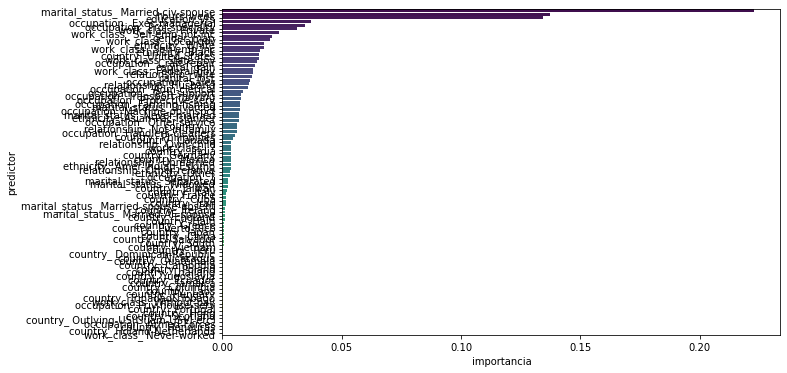

In [ ]:
plt.figure(figsize=(10,6))
sns.barplot(x = "importancia", y = "predictor", data = importancia_predictores, palette="viridis");
plt.show()